In [1]:
import pandas as pd
import os
import sys
from scipy import stats
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import random
import math
import plotly.express as px
import geopandas as gpd
from sklearn.cluster import DBSCAN
from sklearn import metrics
from sklearn.datasets import make_blobs
from sklearn.datasets import make_moons
from sklearn.preprocessing import StandardScaler
from scipy.cluster.hierarchy import linkage, fcluster
from scipy.cluster.vq import whiten
from scipy.cluster.hierarchy import dendrogram
from sklearn.cluster import KMeans
from sklearn import preprocessing
from sklearn.decomposition import PCA
import import_ipynb
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import train_test_split
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (10, 6)
matplotlib.rcParams['figure.facecolor'] = '#00000000'


In [37]:

path = '/Users/zainali/Artificial Intelligence/AI project'

# Constants

In [2]:
#r  C:/Users/mabdu/Documents/DVA project/training_CSV_files_for_clustring
training_CSV_files_for_clustring = f'{path}/training_CSV_files_for_clustring'

#r C:/Users/mabdu/Documents/DVA project/files
file_path = '/Users/zainali/ArtificialIntelligence/AI project/files'
step_two_df_headings = ['location','no_of_businesses','total_reviews','percentage_of_reviews']
pd.set_option('display.max_rows', None)

In [3]:
#r C:/Users/mabdu/Documents/DVA project/all_lahore_and_karachi_locations.csv
df_locations = pd.read_csv('/Users/zainali/Artificial Intelligence/AI project/all_lahore_and_karachi_locations.csv')
list_locations = df_locations['locations'].tolist()
#r C:/Users/mabdu/Documents/DVA project/categories.csv
df_categories = pd.read_csv('/Users/zainali/Artificial Intelligence/AI project/categories.csv')
list_categories = df_categories['categories'].tolist()


# Classifier
## Cassification model for finding sucessfull and unseccessfull businesses  

In [4]:
def read_data_for_clustring(path_url):
    master_df = pd.DataFrame()
    for file in os.listdir(path_url):
        if file.endswith('.csv'):
            print(file)
            cf_df = pd.read_csv(f'{path_url}/{file}', usecols = ['company','address1','profession_id','avg_rating','num_reviews'], encoding= 'ISO-8859-1', low_memory=False)
            cf_df.columns = cf_df.columns.str.replace(' ', '')
            #display(cf_df)
            cf_df = cf_df[['company','address1','profession_id','avg_rating','num_reviews']]
            cf_df.dropna(inplace=True)
            master_df = pd.concat([master_df, cf_df], axis=0)
    return master_df

In [5]:
df = read_data_for_clustring(training_CSV_files_for_clustring)
read_df = df
#read_df

zain_Gulberg_poultry_farming_cat.csv
zain_Retirement_plans.csv
zain_nizamabad_day_care_cat.csv
zain_Mango_Pir_cat.csv
zain_Gulberg.csv
zain_Gulberg_coffe_shop_cat.csv
zain_Gulberg_day_care_cat.csv
zain_Gulberg_Digital_marketing_services_cat.csv


In [6]:
random.randint(30, 40)

30

# Data Wrangling for clustring data

In [7]:
def apply_data_wrangling(read_df,address_col,ratng_col,num_reviews_col):
    #read_df = read_df.head(100)
    read_df = read_df.reset_index()
    for index, oneRow in read_df.iterrows():
        address = str(oneRow[address_col]).strip()
        avg_rating = str(oneRow[ratng_col]).strip()
        num_reviews = str(oneRow[num_reviews_col]).strip()
        num_reviews = num_reviews.replace('-','')
        num_reviews = num_reviews.replace(',','')
        num_reviews = num_reviews.replace('(','')
        num_reviews = num_reviews.replace(')','')
        num_reviews = num_reviews.replace('.','')
        num_reviews = num_reviews.replace('K','')
        if('out of' in avg_rating):
            avg_rating = avg_rating.split(' ',2)
            avg_rating = avg_rating[1]
        read_df.loc[index, ratng_col] = [avg_rating]
        if (len(num_reviews.strip()) != 0):
            if(int(num_reviews)<25):
                read_df = read_df.drop(index=index)

        read_df.loc[index, num_reviews_col] = [int(num_reviews)*random.randint(2, 5)]
        for location in list_locations:
            if location in address:
                read_df.loc[index, 'area'] = [location]

    read_df.dropna(inplace=True)
    read_df.drop('index', axis=1, inplace=True) 
    read_df = read_df.drop_duplicates()
    return read_df


In [8]:
wrangled_df = apply_data_wrangling(read_df,'address1','avg_rating','num_reviews')
wrangled_df


,company,address1,profession_id,avg_rating,num_reviews,area
0,United Poultry products,"W357+QGV, Lyari Expy, Federal B Area Bhangoria...",Poultry farming,4.3,64,Lyari
34,K&N's Chicken Store,Plot No. B-69Ø Shop # 1Ø Main Gulberg Rounda...,Poultry farming,4.1,125,Gulberg
87,Al-Mustafa Sheermal House,"BS-3, Shop # 1&2, Chand Market, Old 5C Bus Sto...",Poultry farming,4.9,183,Gulberg
91,Mazaidar haleem Pakwan centerÛ Ù Ø²ÛØ¯Ø§Ø± Ø...,"R-315 /17 Samnabad St, Federal B Area Block 18...",Poultry farming,4.3,72,Gulberg
93,Sind Feeds and Allied Products,"SIND FEED AND ALLIED PRODUCTS, Mehran Town Sec...",Poultry farming,4.4,330,Korangi
94,SURIYA CATERING,"774, Federal B Area Hussainabad Block 3 Gulber...",Poultry farming,4.7,324,Gulberg
103,Farzan Sweets and Bakers,"Shop E 2A Yousuf Plaza Shara E Pakistan, Karac...",Poultry farming,4.3,78,Gulberg
109,Lalu Khet Birds Market,"W353+884, Sharifabad Laloo Khait Block 10 Liaq...",Poultry farming,4.1,90,Liaquatabad
112,Fast Food & Biryani Club,"R-785, Federal B Area Dastagir Block 15 Gulber...",Poultry farming,4.6,138,Gulberg
118,U.M.Enterprises,"Plot # 12, Sector 15 Korangi Industrial Area, ...",Poultry farming,4.5,224,Korangi


In [9]:
fig6 = px.bar(wrangled_df, x="avg_rating", y="num_reviews",color="num_reviews",pattern_shape="num_reviews")
fig6.write_html("1.html")
fig6.show() #, pattern_shape_sequence=[".", ".", "."]


In [10]:
wrangled_df = wrangled_df[['address1','profession_id','area','avg_rating','num_reviews']]
df_org = wrangled_df
wrangled_df = df_org

# applying Dummy Variable Encoding

In [11]:
def Dummy_Variable_Encoding(df,column_name):
    df1 = pd.get_dummies(df[column_name]) 
    df = pd.concat([df, df1], axis=1).reindex(df.index)
    df.drop(column_name, axis=1, inplace=True)
    return df

In [12]:
wrangled_df.drop('address1', axis=1, inplace=True)
wrangled_df = Dummy_Variable_Encoding(wrangled_df,'area')
wrangled_df = Dummy_Variable_Encoding(wrangled_df,'profession_id')
encoded_df = wrangled_df
#encoded_df

/opt/anaconda3/lib/python3.9/site-packages/pandas/core/frame.py:4906: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [13]:
encoded_df = wrangled_df

In [14]:
encoded_df.to_csv('all in one encoded for clustring.csv',index=False)
encoded_df["num_reviews"] = pd.to_numeric(encoded_df["num_reviews"])


# Visualizing the data to check outliers

In [15]:
print(len(encoded_df))
encoded_df

2782


,avg_rating,num_reviews,Airport,Aram Bagh,Bahria Town,Baldia,Bin Qasim,Civil Line,DHA,Faisal Town,...,Personal chef,Photography,Poultry farming,Real estate Investment,Retirement plans,Soap Making,Solar energy,Touring Company,Translator,skill teaching
0,4.3,64,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
34,4.1,125,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
87,4.9,183,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
91,4.3,72,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
93,4.4,330,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
94,4.7,324,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
103,4.3,78,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
109,4.1,90,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
112,4.6,138,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
118,4.5,224,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0


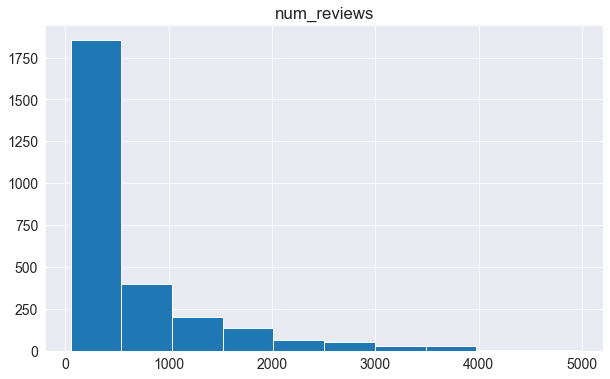

In [16]:
#temp_DataFrame = encoded_df
encoded_df.hist(column="num_reviews")
plt.show()

In [17]:
fig9 = px.histogram(encoded_df, x="num_reviews", color="avg_rating")
fig9.write_html("2.html")
fig9.show()

<AxesSubplot:>

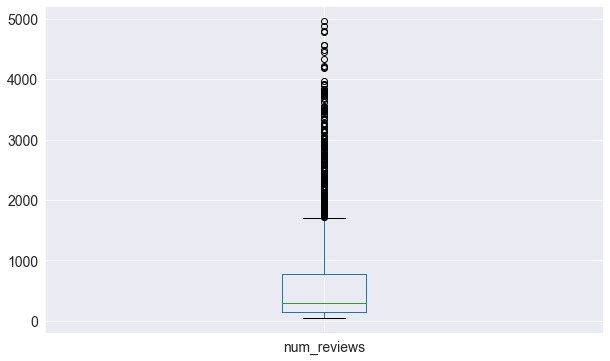

In [18]:
encoded_df.boxplot(column='num_reviews')

# Removing Outliers

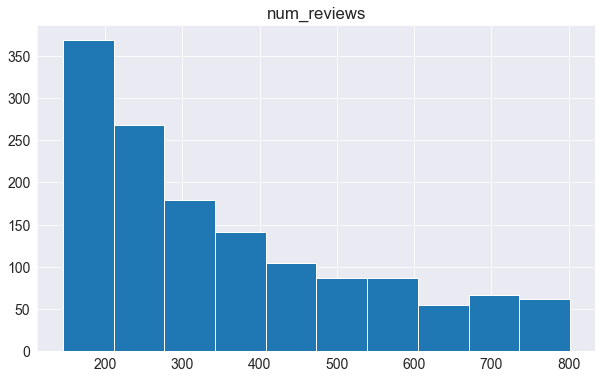

In [19]:
q_low = encoded_df["num_reviews"].quantile(0.25)
q_hi  = encoded_df["num_reviews"].quantile(0.76)

encoded_df = encoded_df[(encoded_df["num_reviews"] < q_hi) & (encoded_df["num_reviews"] > q_low)]
encoded_df.hist(column="num_reviews")
plt.show()

In [20]:
fig10 = px.histogram(encoded_df, x="num_reviews", color="avg_rating")
fig10.write_html("3.html")
fig10.show()

<AxesSubplot:>

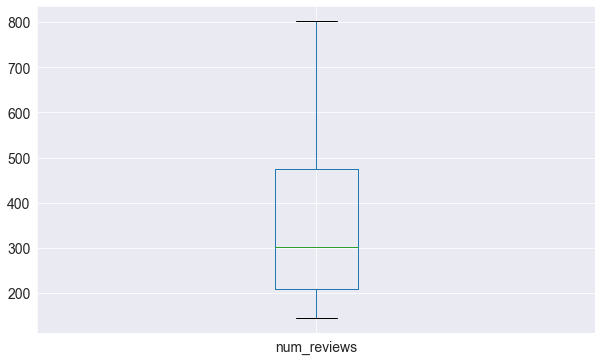

In [21]:
encoded_df.boxplot(column='num_reviews')

In [22]:
fig8 = px.pie(
    encoded_df, 
    values='num_reviews', 
    names='avg_rating', 
    title='Average Ratings per Bussiness',
    color_discrete_sequence=px.colors.sequential.RdBu)
fig8.write_html("4.html")
fig8.show()

In [23]:
len(encoded_df.columns)

67

# Completing Columns

In [24]:
def add_missing_columns(df):
    all_df_columns = df.columns
    for location in list_locations:
        if location not in all_df_columns:
            df[location] = 0
    for categroy in list_categories:
        if categroy not in all_df_columns:
            df[categroy] = 0
    return df
            
    

In [25]:
encoded_df = add_missing_columns(encoded_df)
len(encoded_df.columns)

/var/folders/6n/_sdhr3dx2pz3r0s8n8bxg3v00000gn/T/ipykernel_1065/4108425739.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6n/_sdhr3dx2pz3r0s8n8bxg3v00000gn/T/ipykernel_1065/4108425739.py:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



88

In [26]:
print(len(encoded_df))
encoded_df

1417


,avg_rating,num_reviews,Airport,Aram Bagh,Bahria Town,Baldia,Bin Qasim,Civil Line,DHA,Faisal Town,...,Mazang,Askrai Villa,M M Alam Road,Valencia Town,Ravi Road,Badami Bagh,Digital marketing services,Mushroom farming,Invest in startups,Vacation host
87,4.9,183,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
93,4.4,330,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
94,4.7,324,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
118,4.5,224,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
119,3.7,205,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
138,4.2,315,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
143,3.9,270,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
171,4.2,150,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
173,4.4,210,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
177,4.0,200,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [27]:
input_cols = list(encoded_df.columns)[2:-1]
lin_plot = px.line(encoded_df,x="num_reviews",y=input_cols)

px.bar(df,x="num_reviews",y=input_cols,
       color_discrete_map= {"sepal width":"yellow",
                           "petal length":"red",
                           "petal width":"brown"})

# Applying PCA

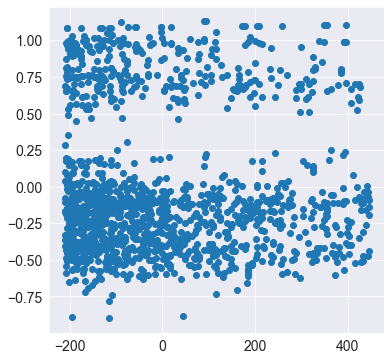

In [28]:
pca = PCA()
components = pca.fit_transform(encoded_df)
c1= components[:,0]
c2= components[:,1]


#Part C:
import matplotlib.pyplot as plt
c1 = components[:,0]
c2 = components[:,1]
fig,ax = plt.subplots(figsize = (6,6))
ax.scatter(c1,c2)
plt.show()

In [29]:
pcadata = pd.DataFrame(data={"0":c1,"1":c2})
pcadata

,0,1
0,-172.939503,-0.249340
1,-25.939421,-0.101783
2,-31.939471,-0.315513
3,-131.939434,-0.069786
4,-150.939265,-0.671679
5,-40.939373,-0.446474
6,-85.939309,-0.599181
7,-205.939364,-0.451540
8,-145.939407,-0.379196
9,-155.939229,-0.252429


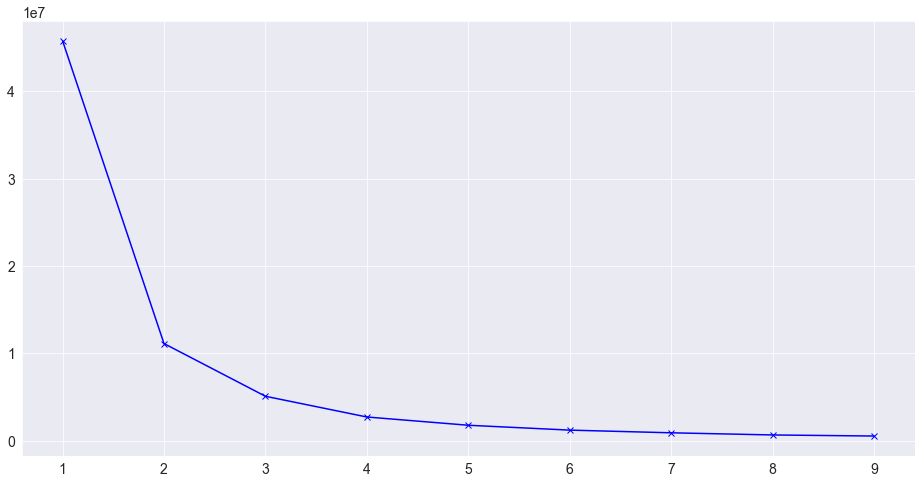

In [30]:
Dis = []
K = range(1,10)
for x in K:
    KM_ = KMeans(x)
    KM_.fit(pcadata)
    Dis.append(KM_.inertia_)
    
plt.figure(figsize=(16,8))
plt.plot(K, Dis, 'bx-')
plt.show()

<AxesSubplot:xlabel='avg_rating', ylabel='num_reviews'>

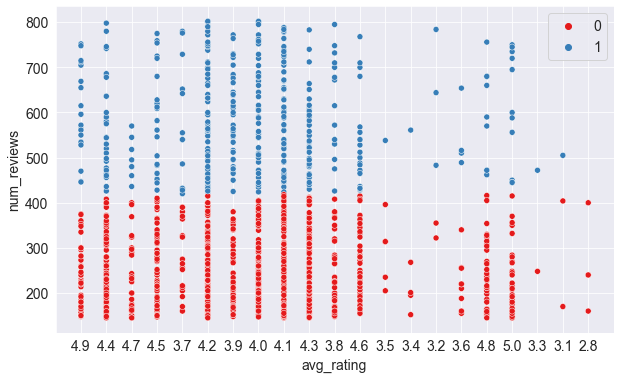

In [31]:
# Code which output time, purity, distiniugable plot 
#Kmeans
KM = KMeans(n_clusters = 2)
Labels1 = KM.fit_predict(pcadata)
sns.scatterplot(x= encoded_df["avg_rating"] , y = encoded_df["num_reviews"] , hue = Labels1 , palette = 'Set1' , data = encoded_df)


In [32]:
encoded_df["Label"] = Labels1
encoded_df[['avg_rating','num_reviews','Label']]
#temp_df = 

/var/folders/6n/_sdhr3dx2pz3r0s8n8bxg3v00000gn/T/ipykernel_1065/1426709256.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,avg_rating,num_reviews,Label
87,4.9,183,0
93,4.4,330,0
94,4.7,324,0
118,4.5,224,0
119,3.7,205,0
138,4.2,315,0
143,3.9,270,0
171,4.2,150,0
173,4.4,210,0
177,4.0,200,0


In [33]:
encoded_df.to_csv('ready data for classification.csv',index=False)

# Training Logistic Regression Model

In [34]:
pd.set_option('max_columns', None)

In [38]:
#r C:/Users/mabdu/Documents/DVA project/ready data for classification.csv
df = pd.read_csv(f"{path}/ready data for classification.csv")

In [39]:
#train_val_df, test_df = train_test_split(df, test_size=0.2, random_state=42)
train_df, test_df = train_test_split(df, test_size=0.25, random_state=42)

In [40]:
print('train_df.shape :', train_df.shape)

print('test_df.shape :', test_df.shape)

train_df.shape : (1062, 89)
test_df.shape : (355, 89)


In [41]:
train_df

,avg_rating,num_reviews,Airport,Aram Bagh,Bahria Town,Baldia,Bin Qasim,Civil Line,DHA,Faisal Town,Gadap,Garden,Gulberg,Gulshan-e-Iqbal,Gulzar-e-Hijri,Harbour,Ibrahim Hyderi,Jamshed Quarters,Johar Town,Korangi,Landhi,Liaquatabad,Lyari,Mauripur,Model Colony,Mominabad,Murad Memon,Nazimabad,New Karachi,North Nazimabad,Orangi,Saddar,Shah Faisal,Beauty salon,Bee farming,Blogging,Boutique,Cake Business,Candle Making,Catering,Coffee shop,Craft Classes,Daycare center,E-commerce site,EBook publishing,Event Management,Fish farming,Food truck,Freelance writing,Gift baskets,Girls hostel,Graphic designing,Gym,House Cleaning Service,Mobile accessories,Online tutoring,Organic farming,Personal chef,Photography,Poultry farming,Real estate Investment,Retirement plans,Soap Making,Solar energy,Touring Company,Translator,skill teaching,Ferozabad,Mango Pir,Sindh Industrial Trading Estate (SITE),Shah Mureed,Samanabad,Gulshan E Ravi,Karim Park,Shad Bagh,Herbuns Pura,Shadman Colony,Airline Society,Mazang,Askrai Villa,M M Alam Road,Valencia Town,Ravi Road,Badami Bagh,Digital marketing services,Mushroom farming,Invest in startups,Vacation host,Label
422,4.2,624,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
199,4.2,284,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
411,4.5,340,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1252,4.8,164,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
526,4.2,372,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
874,4.4,208,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
10,4.0,272,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
147,4.1,738,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
1037,4.3,308,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
282,4.2,164,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [42]:
test_df

,avg_rating,num_reviews,Airport,Aram Bagh,Bahria Town,Baldia,Bin Qasim,Civil Line,DHA,Faisal Town,Gadap,Garden,Gulberg,Gulshan-e-Iqbal,Gulzar-e-Hijri,Harbour,Ibrahim Hyderi,Jamshed Quarters,Johar Town,Korangi,Landhi,Liaquatabad,Lyari,Mauripur,Model Colony,Mominabad,Murad Memon,Nazimabad,New Karachi,North Nazimabad,Orangi,Saddar,Shah Faisal,Beauty salon,Bee farming,Blogging,Boutique,Cake Business,Candle Making,Catering,Coffee shop,Craft Classes,Daycare center,E-commerce site,EBook publishing,Event Management,Fish farming,Food truck,Freelance writing,Gift baskets,Girls hostel,Graphic designing,Gym,House Cleaning Service,Mobile accessories,Online tutoring,Organic farming,Personal chef,Photography,Poultry farming,Real estate Investment,Retirement plans,Soap Making,Solar energy,Touring Company,Translator,skill teaching,Ferozabad,Mango Pir,Sindh Industrial Trading Estate (SITE),Shah Mureed,Samanabad,Gulshan E Ravi,Karim Park,Shad Bagh,Herbuns Pura,Shadman Colony,Airline Society,Mazang,Askrai Villa,M M Alam Road,Valencia Town,Ravi Road,Badami Bagh,Digital marketing services,Mushroom farming,Invest in startups,Vacation host,Label
51,4.1,290,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
481,5.0,186,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
806,4.2,738,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
1260,4.3,537,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
297,4.2,145,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1349,4.1,764,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
916,4.2,162,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
622,4.0,236,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
839,4.9,375,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1230,4.0,190,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [43]:
input_cols = list(train_df.columns)[0:-1]
target_col = 'Label'

In [44]:
print(input_cols)

['avg_rating', 'num_reviews', 'Airport', 'Aram Bagh', 'Bahria Town', 'Baldia', 'Bin Qasim', 'Civil Line', 'DHA', 'Faisal Town', 'Gadap', 'Garden', 'Gulberg', 'Gulshan-e-Iqbal', 'Gulzar-e-Hijri', 'Harbour', 'Ibrahim Hyderi', 'Jamshed Quarters', 'Johar Town', 'Korangi', 'Landhi', 'Liaquatabad', 'Lyari', 'Mauripur', 'Model Colony', 'Mominabad', 'Murad Memon', 'Nazimabad', 'New Karachi', 'North Nazimabad', 'Orangi', 'Saddar', 'Shah Faisal', 'Beauty salon', 'Bee farming', 'Blogging', 'Boutique', 'Cake Business', 'Candle Making', 'Catering', 'Coffee shop', 'Craft Classes', 'Daycare center', 'E-commerce site', 'EBook publishing', 'Event Management', 'Fish farming', 'Food truck', 'Freelance writing', 'Gift baskets', 'Girls hostel', 'Graphic designing', 'Gym', 'House Cleaning Service', 'Mobile accessories', 'Online tutoring', 'Organic farming', 'Personal chef', 'Photography', 'Poultry farming', 'Real estate Investment', 'Retirement plans', 'Soap Making', 'Solar energy', 'Touring Company', 'Tran

In [45]:
target_col

'Label'

In [46]:
train_inputs = train_df[input_cols].copy()
train_targets = train_df[target_col].copy()

test_inputs = test_df[input_cols].copy()
test_targets = test_df[target_col].copy()

In [47]:
numeric_cols = train_inputs.select_dtypes(include=np.number).columns.tolist()
categorical_cols = train_inputs.select_dtypes('object').columns.tolist()

In [48]:
train_inputs[numeric_cols].describe()

,avg_rating,num_reviews,Airport,Aram Bagh,Bahria Town,Baldia,Bin Qasim,Civil Line,DHA,Faisal Town,Gadap,Garden,Gulberg,Gulshan-e-Iqbal,Gulzar-e-Hijri,Harbour,Ibrahim Hyderi,Jamshed Quarters,Johar Town,Korangi,Landhi,Liaquatabad,Lyari,Mauripur,Model Colony,Mominabad,Murad Memon,Nazimabad,New Karachi,North Nazimabad,Orangi,Saddar,Shah Faisal,Beauty salon,Bee farming,Blogging,Boutique,Cake Business,Candle Making,Catering,Coffee shop,Craft Classes,Daycare center,E-commerce site,EBook publishing,Event Management,Fish farming,Food truck,Freelance writing,Gift baskets,Girls hostel,Graphic designing,Gym,House Cleaning Service,Mobile accessories,Online tutoring,Organic farming,Personal chef,Photography,Poultry farming,Real estate Investment,Retirement plans,Soap Making,Solar energy,Touring Company,Translator,skill teaching,Ferozabad,Mango Pir,Sindh Industrial Trading Estate (SITE),Shah Mureed,Samanabad,Gulshan E Ravi,Karim Park,Shad Bagh,Herbuns Pura,Shadman Colony,Airline Society,Mazang,Askrai Villa,M M Alam Road,Valencia Town,Ravi Road,Badami Bagh,Digital marketing services,Mushroom farming,Invest in startups,Vacation host
count,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0
mean,4.280414,352.709981,0.002825,0.004708,0.008475,0.003766,0.015066,0.007533,0.015066,0.002825,0.014124,0.025424,0.183616,0.241996,0.003766,0.008475,0.006591,0.016949,0.005650,0.024482,0.011299,0.042373,0.003766,0.005650,0.008475,0.000942,0.003766,0.072505,0.018832,0.169492,0.004708,0.043315,0.023540,0.098870,0.006591,0.018832,0.059322,0.045198,0.021657,0.043315,0.048964,0.031073,0.014124,0.025424,0.027307,0.013183,0.025424,0.041431,0.004708,0.052731,0.006591,0.047081,0.064030,0.024482,0.033898,0.008475,0.016949,0.015066,0.016949,0.092279,0.019774,0.004708,0.016949,0.008475,0.019774,0.012241,0.014124,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
std,0.357935,178.076694,0.053099,0.068486,0.091710,0.061285,0.121873,0.086506,0.121873,0.053099,0.118059,0.157482,0.387353,0.428494,0.061285,0.091710,0.080957,0.129142,0.074987,0.154613,0.105746,0.201533,0.061285,0.074987,0.091710,0.030686,0.061285,0.259444,0.135997,0.375362,0.068486,0.203660,0.151684,0.298628,0.080957,0.135997,0.236338,0.207835,0.145630,0.203660,0.215895,0.173598,0.118059,0.157482,0.163053,0.114110,0.157482,0.199379,0.068486,0.223601,0.080957,0.211912,0.244922,0.154613,0.181053,0.091710,0.129142,0.121873,0.129142,0.289555,0.139288,0.068486,0.129142,0.091710,0.139288,0.110012,0.118059,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
min,2.800000,145.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0

In [49]:
train_inputs[categorical_cols].nunique()

Series([], dtype: float64)

In [50]:
train_inputs[numeric_cols].isna().sum()

avg_rating                                0
num_reviews                               0
Airport                                   0
Aram Bagh                                 0
Bahria Town                               0
Baldia                                    0
Bin Qasim                                 0
Civil Line                                0
DHA                                       0
Faisal Town                               0
Gadap                                     0
Garden                                    0
Gulberg                                   0
Gulshan-e-Iqbal                           0
Gulzar-e-Hijri                            0
Harbour                                   0
Ibrahim Hyderi                            0
Jamshed Quarters                          0
Johar Town                                0
Korangi                                   0
Landhi                                    0
Liaquatabad                               0
Lyari                           

In [51]:
df[numeric_cols].describe()

,avg_rating,num_reviews,Airport,Aram Bagh,Bahria Town,Baldia,Bin Qasim,Civil Line,DHA,Faisal Town,Gadap,Garden,Gulberg,Gulshan-e-Iqbal,Gulzar-e-Hijri,Harbour,Ibrahim Hyderi,Jamshed Quarters,Johar Town,Korangi,Landhi,Liaquatabad,Lyari,Mauripur,Model Colony,Mominabad,Murad Memon,Nazimabad,New Karachi,North Nazimabad,Orangi,Saddar,Shah Faisal,Beauty salon,Bee farming,Blogging,Boutique,Cake Business,Candle Making,Catering,Coffee shop,Craft Classes,Daycare center,E-commerce site,EBook publishing,Event Management,Fish farming,Food truck,Freelance writing,Gift baskets,Girls hostel,Graphic designing,Gym,House Cleaning Service,Mobile accessories,Online tutoring,Organic farming,Personal chef,Photography,Poultry farming,Real estate Investment,Retirement plans,Soap Making,Solar energy,Touring Company,Translator,skill teaching,Ferozabad,Mango Pir,Sindh Industrial Trading Estate (SITE),Shah Mureed,Samanabad,Gulshan E Ravi,Karim Park,Shad Bagh,Herbuns Pura,Shadman Colony,Airline Society,Mazang,Askrai Villa,M M Alam Road,Valencia Town,Ravi Road,Badami Bagh,Digital marketing services,Mushroom farming,Invest in startups,Vacation host
count,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.000000,1417.0,1417.0,1417.0,1417.0,1417.0,1417.0,1417.0,1417.0,1417.0,1417.0,1417.0,1417.0,1417.0,1417.0,1417.0,1417.0,1417.0,1417.0,1417.0,1417.0,1417.0
mean,4.268807,355.939308,0.002823,0.004234,0.007763,0.003529,0.013409,0.009174,0.014820,0.002117,0.016937,0.029640,0.178546,0.235004,0.004234,0.006351,0.007057,0.017643,0.005646,0.030346,0.011291,0.038814,0.002823,0.006351,0.008469,0.000706,0.002823,0.076217,0.021171,0.171489,0.004234,0.045872,0.020466,0.099506,0.004940,0.017643,0.056457,0.050106,0.022583,0.043049,0.053634,0.029640,0.013409,0.023994,0.025406,0.011997,0.024700,0.042343,0.007057,0.057869,0.007763,0.043754,0.069160,0.026112,0.035286,0.009880,0.014820,0.011997,0.018349,0.088920,0.021171,0.005646,0.015526,0.009880,0.016231,0.010586,0.010586,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
std,0.353834,179.846821,0.053074,0.064956,0.087796,0.059318,0.115057,0.095376,0.120875,0.045980,0.129082,0.169652,0.383107,0.424151,0.064956,0.079471,0.083740,0.131696,0.074952,0.171598,0.105697,0.193221,0.053074,0.079471,0.091667,0.026565,0.053074,0.265439,0.144007,0.377069,0.064956,0.209280,0.141637,0.299446,0.070136,0.131696,0.230884,0.218240,0.148622,0.203038,0.225374,0.169652,0.115057,0.153085,0.157410,0.108911,0.155264,0.201442,0.083740,0.233578,0.087796,0.204620,0.253816,0.159523,0.184566,0.098941,0.120875,0.108911,0.134256,0.284729,0.144007,0.074952,0.123675,0.098941,0.126409,0.102377,0.102377,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
min,2.800000,145.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0

In [52]:
scaler = MinMaxScaler()

In [53]:
scaler.fit(df[numeric_cols])

MinMaxScaler()

In [54]:
train_inputs[numeric_cols] = scaler.transform(train_inputs[numeric_cols])

test_inputs[numeric_cols] = scaler.transform(test_inputs[numeric_cols])

In [55]:
train_inputs[numeric_cols].describe()

,avg_rating,num_reviews,Airport,Aram Bagh,Bahria Town,Baldia,Bin Qasim,Civil Line,DHA,Faisal Town,Gadap,Garden,Gulberg,Gulshan-e-Iqbal,Gulzar-e-Hijri,Harbour,Ibrahim Hyderi,Jamshed Quarters,Johar Town,Korangi,Landhi,Liaquatabad,Lyari,Mauripur,Model Colony,Mominabad,Murad Memon,Nazimabad,New Karachi,North Nazimabad,Orangi,Saddar,Shah Faisal,Beauty salon,Bee farming,Blogging,Boutique,Cake Business,Candle Making,Catering,Coffee shop,Craft Classes,Daycare center,E-commerce site,EBook publishing,Event Management,Fish farming,Food truck,Freelance writing,Gift baskets,Girls hostel,Graphic designing,Gym,House Cleaning Service,Mobile accessories,Online tutoring,Organic farming,Personal chef,Photography,Poultry farming,Real estate Investment,Retirement plans,Soap Making,Solar energy,Touring Company,Translator,skill teaching,Ferozabad,Mango Pir,Sindh Industrial Trading Estate (SITE),Shah Mureed,Samanabad,Gulshan E Ravi,Karim Park,Shad Bagh,Herbuns Pura,Shadman Colony,Airline Society,Mazang,Askrai Villa,M M Alam Road,Valencia Town,Ravi Road,Badami Bagh,Digital marketing services,Mushroom farming,Invest in startups,Vacation host
count,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.000000,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0,1062.0
mean,0.672916,0.316149,0.002825,0.004708,0.008475,0.003766,0.015066,0.007533,0.015066,0.002825,0.014124,0.025424,0.183616,0.241996,0.003766,0.008475,0.006591,0.016949,0.005650,0.024482,0.011299,0.042373,0.003766,0.005650,0.008475,0.000942,0.003766,0.072505,0.018832,0.169492,0.004708,0.043315,0.023540,0.098870,0.006591,0.018832,0.059322,0.045198,0.021657,0.043315,0.048964,0.031073,0.014124,0.025424,0.027307,0.013183,0.025424,0.041431,0.004708,0.052731,0.006591,0.047081,0.064030,0.024482,0.033898,0.008475,0.016949,0.015066,0.016949,0.092279,0.019774,0.004708,0.016949,0.008475,0.019774,0.012241,0.014124,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
std,0.162698,0.271045,0.053099,0.068486,0.091710,0.061285,0.121873,0.086506,0.121873,0.053099,0.118059,0.157482,0.387353,0.428494,0.061285,0.091710,0.080957,0.129142,0.074987,0.154613,0.105746,0.201533,0.061285,0.074987,0.091710,0.030686,0.061285,0.259444,0.135997,0.375362,0.068486,0.203660,0.151684,0.298628,0.080957,0.135997,0.236338,0.207835,0.145630,0.203660,0.215895,0.173598,0.118059,0.157482,0.163053,0.114110,0.157482,0.199379,0.068486,0.223601,0.080957,0.211912,0.244922,0.154613,0.181053,0.091710,0.129142,0.121873,0.129142,0.289555,0.139288,0.068486,0.129142,0.091710,0.139288,0.110012,0.118059,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,

In [56]:
test_inputs[numeric_cols].describe()

,avg_rating,num_reviews,Airport,Aram Bagh,Bahria Town,Baldia,Bin Qasim,Civil Line,DHA,Faisal Town,Gadap,Garden,Gulberg,Gulshan-e-Iqbal,Gulzar-e-Hijri,Harbour,Ibrahim Hyderi,Jamshed Quarters,Johar Town,Korangi,Landhi,Liaquatabad,Lyari,Mauripur,Model Colony,Mominabad,Murad Memon,Nazimabad,New Karachi,North Nazimabad,Orangi,Saddar,Shah Faisal,Beauty salon,Bee farming,Blogging,Boutique,Cake Business,Candle Making,Catering,Coffee shop,Craft Classes,Daycare center,E-commerce site,EBook publishing,Event Management,Fish farming,Food truck,Freelance writing,Gift baskets,Girls hostel,Graphic designing,Gym,House Cleaning Service,Mobile accessories,Online tutoring,Organic farming,Personal chef,Photography,Poultry farming,Real estate Investment,Retirement plans,Soap Making,Solar energy,Touring Company,Translator,skill teaching,Ferozabad,Mango Pir,Sindh Industrial Trading Estate (SITE),Shah Mureed,Samanabad,Gulshan E Ravi,Karim Park,Shad Bagh,Herbuns Pura,Shadman Colony,Airline Society,Mazang,Askrai Villa,M M Alam Road,Valencia Town,Ravi Road,Badami Bagh,Digital marketing services,Mushroom farming,Invest in startups,Vacation host
count,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.0,355.000000,355.000000,355.000000,355.000000,355.000000,355.0,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.0,355.000000,355.000000,355.0,355.0,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.0,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.000000,355.0,355.0,355.0,355.0,355.0,355.0,355.0,355.0,355.0,355.0,355.0,355.0,355.0,355.0,355.0,355.0,355.0,355.0,355.0,355.0,355.0,355.0
mean,0.651857,0.335769,0.002817,0.002817,0.005634,0.002817,0.008451,0.014085,0.014085,0.0,0.025352,0.042254,0.163380,0.214085,0.005634,0.0,0.008451,0.019718,0.005634,0.047887,0.011268,0.028169,0.0,0.008451,0.008451,0.0,0.0,0.087324,0.028169,0.177465,0.002817,0.053521,0.011268,0.101408,0.0,0.014085,0.047887,0.064789,0.025352,0.042254,0.067606,0.025352,0.011268,0.019718,0.019718,0.008451,0.022535,0.045070,0.014085,0.073239,0.011268,0.033803,0.084507,0.030986,0.039437,0.014085,0.008451,0.002817,0.022535,0.078873,0.025352,0.008451,0.011268,0.014085,0.005634,0.005634,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
std,0.154272,0.281522,0.053074,0.053074,0.074953,0.053074,0.091668,0.118006,0.118006,0.0,0.157414,0.201451,0.370234,0.410765,0.074953,0.0,0.091668,0.139227,0.074953,0.213829,0.105698,0.165689,0.0,0.091668,0.091668,0.0,0.0,0.282708,0.165689,0.382601,0.053074,0.225388,0.105698,0.302295,0.0,0.118006,0.213829,0.246500,0.157414,0.201451,0.251422,0.157414,0.105698,0.139227,0.139227,0.091668,0.148626,0.207751,0.118006,0.260897,0.105698,0.180976,0.278539,0.173524,0.194906,0.118006,0.091668,0.053074,0.148626,0.269921,0.157414,0.091668,0.105698,0.118006,0.074953,0.074953,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
25%,0.590909,0.100457,0.000000,0.000000,0.000000,0.000000,0.000

In [57]:
print('train_inputs:', train_inputs.shape)
print('train_targets:', train_targets.shape)

train_inputs: (1062, 88)
train_targets: (1062,)


In [58]:
!pip install pyarrow --quiet
train_inputs.to_parquet('train_inputs.parquet')
test_inputs.to_parquet('test_inputs.parquet')

pd.DataFrame(train_targets).to_parquet('train_targets.parquet')
pd.DataFrame(test_targets).to_parquet('test_targets.parquet')

train_inputs = pd.read_parquet('train_inputs.parquet')
test_inputs = pd.read_parquet('test_inputs.parquet')

train_targets = pd.read_parquet('train_targets.parquet')[target_col]
test_targets = pd.read_parquet('test_targets.parquet')[target_col]

#checking if it stored or not ??
print('train_inputs:', train_inputs.shape)
print('train_targets:', train_targets.shape)
print('test_inputs:', test_inputs.shape)
print('test_targets:', test_targets.shape)

train_inputs: (1062, 88)
train_targets: (1062,)
test_inputs: (355, 88)
test_targets: (355,)


In [59]:
model = LogisticRegression(solver='liblinear')

In [60]:
model.fit(train_inputs[numeric_cols], train_targets)

LogisticRegression(solver='liblinear')

In [61]:
#Let's check the weights and biases of the trained model.

print(numeric_cols)


['avg_rating', 'num_reviews', 'Airport', 'Aram Bagh', 'Bahria Town', 'Baldia', 'Bin Qasim', 'Civil Line', 'DHA', 'Faisal Town', 'Gadap', 'Garden', 'Gulberg', 'Gulshan-e-Iqbal', 'Gulzar-e-Hijri', 'Harbour', 'Ibrahim Hyderi', 'Jamshed Quarters', 'Johar Town', 'Korangi', 'Landhi', 'Liaquatabad', 'Lyari', 'Mauripur', 'Model Colony', 'Mominabad', 'Murad Memon', 'Nazimabad', 'New Karachi', 'North Nazimabad', 'Orangi', 'Saddar', 'Shah Faisal', 'Beauty salon', 'Bee farming', 'Blogging', 'Boutique', 'Cake Business', 'Candle Making', 'Catering', 'Coffee shop', 'Craft Classes', 'Daycare center', 'E-commerce site', 'EBook publishing', 'Event Management', 'Fish farming', 'Food truck', 'Freelance writing', 'Gift baskets', 'Girls hostel', 'Graphic designing', 'Gym', 'House Cleaning Service', 'Mobile accessories', 'Online tutoring', 'Organic farming', 'Personal chef', 'Photography', 'Poultry farming', 'Real estate Investment', 'Retirement plans', 'Soap Making', 'Solar energy', 'Touring Company', 'Tran

In [62]:
X_train = train_inputs[numeric_cols]
X_test = test_inputs[numeric_cols]
train_preds = model.predict(X_train)

In [63]:
train_preds

array([1, 0, 0, ..., 1, 0, 0])

In [64]:
train_targets

422     1
199     0
411     0
1252    0
526     0
874     0
10      0
147     1
1037    0
282     0
298     0
551     0
291     0
1101    0
1033    0
1131    0
527     0
1352    0
331     0
323     0
906     0
990     0
497     0
135     0
1009    1
1000    0
649     0
591     0
589     1
1046    0
597     0
158     1
1224    0
552     0
423     0
755     0
1227    0
826     0
968     0
532     0
573     0
1234    0
1173    0
1325    1
96      0
479     0
621     1
1385    0
1274    0
156     0
558     0
1042    0
435     0
985     0
390     0
704     0
918     0
1221    0
1220    0
415     0
429     0
308     0
964     0
1079    0
1169    0
962     1
720     0
705     0
352     1
666     0
124     1
178     0
287     1
1365    0
1174    1
294     0
900     0
898     0
780     0
682     0
1067    0
236     1
88      0
1371    0
915     0
857     0
1317    0
1313    0
844     1
1243    1
846     0
1041    0
290     0
285     0
1137    0
1343    0
535     0
808     0
266     1
327     0


In [65]:
#We can output a probabilistic prediction using predict_proba.

train_probs = model.predict_proba(X_train)
train_probs

array([[0.04708667, 0.95291333],
       [0.87632125, 0.12367875],
       [0.90431523, 0.09568477],
       ...,
       [0.07557932, 0.92442068],
       [0.98542314, 0.01457686],
       [0.96761436, 0.03238564]])

In [66]:
model.classes_

array([0, 1])

In [67]:
#We can test the accuracy of the model's predictions.
accuracy_score(train_targets, train_preds)

0.9887005649717514

In [68]:
confusion_matrix(train_targets, train_preds, normalize='true')

array([[1.        , 0.        ],
       [0.03680982, 0.96319018]])

In [69]:
def predict_and_plot(inputs, targets, name=''):
    preds = model.predict(inputs)
    
    accuracy = accuracy_score(targets, preds)
    print("Accuracy: {:.2f}%".format(accuracy * 100))
    
    cf = confusion_matrix(targets, preds, normalize='true')
    plt.figure()
    sns.heatmap(cf, annot=True)
    plt.xlabel('Prediction')
    plt.ylabel('Target')
    plt.title('{} Confusion Matrix'.format(name));
    
    return preds

Accuracy: 98.87%


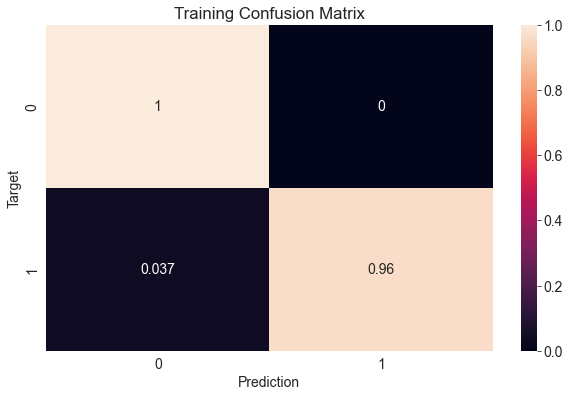

In [70]:
train_preds = predict_and_plot(X_train, train_targets, 'Training')

Accuracy: 97.18%


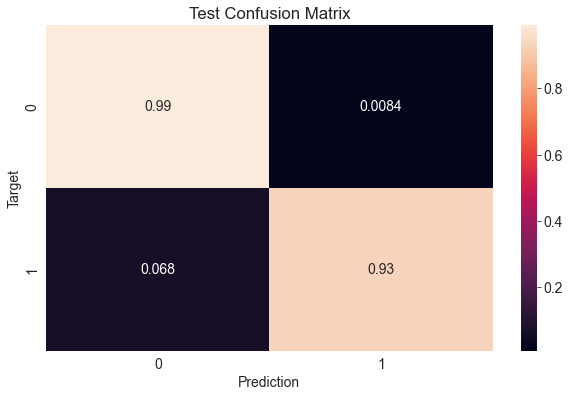

In [71]:
test_preds = predict_and_plot(X_test, test_targets, 'Test')

In [72]:
def Apply_Logistic_Regression(df):
    df = add_missing_columns(df)
    predictions = model.predict(df)
    return predictions

# V1 code

In [73]:
os.chdir(file_path)
category_list = []
meta_data_df = pd.DataFrame(columns=['Category Name','Number of Listings'])

id = 19162
i=1
for file in os.listdir(os.getcwd()):
    if file.endswith('.csv'):
        file = file.split('_',1)
        file = file[0]
        if(file not in category_list):
            category_list.append(file)
            print(i,": ",file)
            i = i+1

1 :  Poultry farming
2 :  Photography
3 :  House Cleaning Service
4 :  Beauty salon
5 :  Real estate Investment
6 :  skill teaching
7 :  Meta Data.csv


In [85]:
cat_number = input("Enter category by number: ")

Enter category by number: 4


In [86]:
category_to_continue_with = category_list[int(cat_number)-1]
category_to_continue_with

'Beauty salon'

In [87]:
master_df = pd.DataFrame(columns=step_two_df_headings)
all_in_one_df = pd.DataFrame()
for file in os.listdir(os.getcwd()):
    if file.endswith('.csv') and category_to_continue_with in file:
        temp_df = pd.read_csv(file)
        all_in_one_df = pd.concat([all_in_one_df, temp_df], ignore_index=True)
        total_rows = len(temp_df) #
        temp_df.replace(',','', regex=True, inplace=True)
        temp_df = temp_df[['no_of_reviews','rating']]
        #print(temp_df)
        temp_df.dropna(inplace=True)
        
        loc_temp = file.split('_',1)
        loc_temp = loc_temp[1]
        loc_temp = loc_temp.replace(".csv",'')
        loc_temp = loc_temp.replace("Lahore Pakistan",'')
        location = loc_temp 
        #temp_df['no_of_reviews'] = pd.to_numeric(temp_df['no_of_reviews'])
        #total_reviews = temp_df['no_of_reviews'].sum()
        #temp_dic = {'location':location,'no_of_businesses':total_rows,'total_reviews':total_reviews,'percentage_of_reviews':total_reviews/total_rows}
        #tdf = pd.DataFrame([temp_dic])
        #master_df = pd.concat([master_df, tdf], ignore_index=True)
        #print(temp_dic)
        
#df = pd.read_csv(f'{file_path}/{category_to_continue_with}')
#df

In [88]:
org_all_in_one_df = all_in_one_df.copy()
#org_all_in_one_df = org_all_in_one_df[['company','address1','lat','lon']]
all_in_one_df = all_in_one_df[['company','address1','lat','lon','services','rating','no_of_reviews']]

In [89]:
all_in_one_df = all_in_one_df[all_in_one_df['no_of_reviews'].notna()]
all_in_one_df.columns

Index(['company', 'address1', 'lat', 'lon', 'services', 'rating',
       'no_of_reviews'],
      dtype='object')

In [90]:
all_in_one_df = apply_data_wrangling(all_in_one_df,'address1','rating','no_of_reviews')
len(all_in_one_df)

1542

In [91]:
z_df = all_in_one_df

In [92]:
#all_in_one_df = z_df
#all_in_one_df

In [93]:
def find_aeas(read_df):
    read_df = read_df.reset_index()
    
    for index, oneRow in read_df.iterrows():
        address = str(oneRow['address1']).strip()
        for location in list_locations:
                if location in address:
                    read_df.loc[index, 'area'] = [location]
    read_df.drop('index', axis=1, inplace=True)
    read_df.dropna(inplace=True)
    read_df = read_df.drop_duplicates()
    return read_df

In [94]:
print(len(all_in_one_df))
all_in_one_df = find_aeas(all_in_one_df)
all_in_one_df

1542


,company,address1,lat,lon,services,rating,no_of_reviews,area
0,Dessange Pakistan DHA Phase 4,"Plot 184, DHA Phase 4 Sector DD Dha Phase 4, L...",31.464375999999998,74.385898,Beauty salon,4.1,3200,DHA
1,Allure Beauty Salon & Training Institute,"746 G/4 , Khokhar Chowk, near Emporium Mall, J...",31.469814,74.271126,Beauty salon,4.8,15650,Johar Town
2,Anya's Salon & Spa,"81 D1 Block D Phase 1 Johar Town, Lahore, Punj...",31.454288799999993,74.2848434,Beauty salon,4.4,2640,Johar Town
3,Feme Beauty Salon,"30 Awasia Housing Society, College Road, Johar...",31.438009800000003,74.2894496,Beauty salon,3.8,2180,Johar Town
4,Shades Beauty Salon,"Block C2 Block C 2 Phase 1 Johar Town, Lahore,...",31.451349399999998,74.28924719999999,Beauty salon,4.6,3350,Johar Town
5,Zarwa Beauty Parlour,"649 house, Block G4 Block G 4 Phase 2 Johar To...",31.4712782,74.2714611,Beauty salon,4.7,3000,Johar Town
6,Farah Beauty Salon,"C6Q6+6XM, Block E DHA EME Sector, Lahore, Punjab",31.438076100000004,74.2124269,Beauty salon,4.2,1110,DHA
7,Coral Beauty Emporium Johar Town Lahore,"No 599 Main Blvd, opposite Pizza Hut, Block Q ...",31.462487900000003,74.274714,Beauty salon,4.9,2100,Johar Town
8,"Reservim - Book best Beauty Salons, Hair Styli...","644, near Gourmet, Airline Society, Lahore, Pu...",31.440790099999994,74.2676501,Beauty salon,5.0,600,Airline Society
9,Seeme Beauty Parlour,"Allah hu Chowk, 43 A-Block, Johar Town, Near، ...",31.4700074,74.3011295,Beauty salon,4.0,3560,Johar Town


# Applying dummy variable encoding

In [95]:
all_in_one_df = Dummy_Variable_Encoding(all_in_one_df,'area')
all_in_one_df = Dummy_Variable_Encoding(all_in_one_df,'services')
org_all_in_one_df = all_in_one_df.copy()
all_in_one_df = add_missing_columns(all_in_one_df)
all_in_one_df.drop('address1', axis=1, inplace=True)
all_in_one_df.drop('company', axis=1, inplace=True)
all_in_one_df.drop('lat', axis=1, inplace=True)
all_in_one_df.drop('lon', axis=1, inplace=True)



In [96]:
org_all_in_one_df

,company,address1,lat,lon,rating,no_of_reviews,Airline Society,Airport,Bahria Town,Civil Line,DHA,Faisal Town,Garden,Gulberg,Gulshan-e-Iqbal,Johar Town,Karim Park,Mazang,Model Colony,Saddar,Samanabad,Shad Bagh,Shadman Colony,Beauty salon
0,Dessange Pakistan DHA Phase 4,"Plot 184, DHA Phase 4 Sector DD Dha Phase 4, L...",31.464375999999998,74.385898,4.1,3200,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1
1,Allure Beauty Salon & Training Institute,"746 G/4 , Khokhar Chowk, near Emporium Mall, J...",31.469814,74.271126,4.8,15650,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
2,Anya's Salon & Spa,"81 D1 Block D Phase 1 Johar Town, Lahore, Punj...",31.454288799999993,74.2848434,4.4,2640,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
3,Feme Beauty Salon,"30 Awasia Housing Society, College Road, Johar...",31.438009800000003,74.2894496,3.8,2180,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
4,Shades Beauty Salon,"Block C2 Block C 2 Phase 1 Johar Town, Lahore,...",31.451349399999998,74.28924719999999,4.6,3350,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
5,Zarwa Beauty Parlour,"649 house, Block G4 Block G 4 Phase 2 Johar To...",31.4712782,74.2714611,4.7,3000,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
6,Farah Beauty Salon,"C6Q6+6XM, Block E DHA EME Sector, Lahore, Punjab",31.438076100000004,74.2124269,4.2,1110,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1
7,Coral Beauty Emporium Johar Town Lahore,"No 599 Main Blvd, opposite Pizza Hut, Block Q ...",31.462487900000003,74.274714,4.9,2100,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
8,"Reservim - Book best Beauty Salons, Hair Styli...","644, near Gourmet, Airline Society, Lahore, Pu...",31.440790099999994,74.2676501,5.0,600,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
9,Seeme Beauty Parlour,"Allah hu Chowk, 43 A-Block, Johar Town, Near، ...",31.4700074,74.3011295,4.0,3560,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1


In [97]:
len( all_in_one_df.columns)

88

In [98]:
#numeric_cols = all_in_one_df.select_dtypes(include=np.number).columns.tolist()
cols = all_in_one_df.columns
all_in_one_df[cols] = scaler.transform(all_in_one_df[cols])



/opt/anaconda3/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning:

The feature names should match those that were passed during fit. Starting version 1.2, an error will be raised.
Feature names unseen at fit time:
- no_of_reviews
- rating
Feature names seen at fit time, yet now missing:
- avg_rating
- num_reviews




In [99]:
result = Apply_Logistic_Regression(all_in_one_df)

/opt/anaconda3/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning:

The feature names should match those that were passed during fit. Starting version 1.2, an error will be raised.
Feature names unseen at fit time:
- no_of_reviews
- rating
Feature names seen at fit time, yet now missing:
- avg_rating
- num_reviews




In [100]:
org_all_in_one_df

,company,address1,lat,lon,rating,no_of_reviews,Airline Society,Airport,Bahria Town,Civil Line,DHA,Faisal Town,Garden,Gulberg,Gulshan-e-Iqbal,Johar Town,Karim Park,Mazang,Model Colony,Saddar,Samanabad,Shad Bagh,Shadman Colony,Beauty salon
0,Dessange Pakistan DHA Phase 4,"Plot 184, DHA Phase 4 Sector DD Dha Phase 4, L...",31.464375999999998,74.385898,4.1,3200,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1
1,Allure Beauty Salon & Training Institute,"746 G/4 , Khokhar Chowk, near Emporium Mall, J...",31.469814,74.271126,4.8,15650,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
2,Anya's Salon & Spa,"81 D1 Block D Phase 1 Johar Town, Lahore, Punj...",31.454288799999993,74.2848434,4.4,2640,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
3,Feme Beauty Salon,"30 Awasia Housing Society, College Road, Johar...",31.438009800000003,74.2894496,3.8,2180,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
4,Shades Beauty Salon,"Block C2 Block C 2 Phase 1 Johar Town, Lahore,...",31.451349399999998,74.28924719999999,4.6,3350,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
5,Zarwa Beauty Parlour,"649 house, Block G4 Block G 4 Phase 2 Johar To...",31.4712782,74.2714611,4.7,3000,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
6,Farah Beauty Salon,"C6Q6+6XM, Block E DHA EME Sector, Lahore, Punjab",31.438076100000004,74.2124269,4.2,1110,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1
7,Coral Beauty Emporium Johar Town Lahore,"No 599 Main Blvd, opposite Pizza Hut, Block Q ...",31.462487900000003,74.274714,4.9,2100,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
8,"Reservim - Book best Beauty Salons, Hair Styli...","644, near Gourmet, Airline Society, Lahore, Pu...",31.440790099999994,74.2676501,5.0,600,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
9,Seeme Beauty Parlour,"Allah hu Chowk, 43 A-Block, Johar Town, Near، ...",31.4700074,74.3011295,4.0,3560,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1


In [101]:
org_all_in_one_df['label'] = result
org_all_in_one_df[['rating','no_of_reviews','label']]

,rating,no_of_reviews,label
0,4.1,3200,1
1,4.8,15650,1
2,4.4,2640,1
3,3.8,2180,1
4,4.6,3350,1
5,4.7,3000,1
6,4.2,1110,1
7,4.9,2100,1
8,5.0,600,1
9,4.0,3560,1


In [102]:
fig1 = px.scatter_3d(df, 
                     x=org_all_in_one_df["rating"], 
                     y = org_all_in_one_df["no_of_reviews"],
                     z = org_all_in_one_df["label"],
              color=org_all_in_one_df["rating"])
fig1.write_html("5.html")
fig1.show()

In [103]:
org_all_in_one_df = org_all_in_one_df.loc[org_all_in_one_df['label'] == 0]
org_all_in_one_df = org_all_in_one_df.astype({'rating':'float'})
org_all_in_one_df = org_all_in_one_df.astype({'no_of_reviews':'int'})

org_all_in_one_df = org_all_in_one_df.loc[org_all_in_one_df['rating'] < 4]
org_all_in_one_df[['rating','no_of_reviews','label']]

,rating,no_of_reviews,label
53,3.6,335,0
58,3.8,142,0
59,3.9,324,0
76,3.8,300,0
105,3.7,220,0
121,3.9,250,0
122,3.6,268,0
135,3.8,327,0
145,3.8,58,0
147,3.3,54,0


In [104]:
selected_rows = org_all_in_one_df.sort_values(by=['no_of_reviews'], ascending=False)
selected_rows[['rating','no_of_reviews','label']]

,rating,no_of_reviews,label
669,3.8,436,0
1368,3.3,420,0
578,3.9,408,0
671,3.8,384,0
1419,3.9,376,0
398,3.9,376,0
1077,3.8,372,0
878,3.8,372,0
773,3.6,368,0
163,3.4,360,0


In [105]:
org_all_in_one_df = org_all_in_one_df[['company','address1','lat','lon','rating','no_of_reviews','label']]

In [106]:
org_all_in_one_df.sort_values(by=['no_of_reviews'], ascending=False)

,company,address1,lat,lon,rating,no_of_reviews,label
669,Feme Beauty Salon,"30 Awasia Housing Society, College Road, Johar...",31.438009800000003,74.2894496,3.8,436,0
1368,Shafique Hair Salon,"F7C5+MRW, Block H-3 Block H 3 Phase 2 Johar To...",31.471739,74.259574,3.3,420,0
578,Saba Salon,"17/2 T, Block T Gulberg 2, Lahore, Punjab",31.519093,74.35550649999999,3.9,408,0
671,Rehman Beauty Salon,"24 Commercial Zone, Liberty Market Rd, Liberty...",31.511307000000002,74.3443016,3.8,384,0
1419,Allenora Beauty Saloon Johar Town,"156, Khokhar Chowk, Block M Phase 2 Johar Town...",31.467664,74.273743,3.9,376,0
398,Allenora Beauty Saloon Johar Town,"156, Khokhar Chowk, Block M Phase 2 Johar Town...",31.467663899999998,74.2737428,3.9,376,0
1077,Blazon Salon and Studio Lahore,"B1, 271 Allah Hoo Chowk, Block B1 Block B 1 Ph...",31.4680936,74.3002092,3.8,372,0
878,Blazon Salon and Studio Lahore,"B1, 271 Allah Hoo Chowk, Block B1 Block B 1 Ph...",31.468094,74.300209,3.8,372,0
773,Kashee's Kingdom Lahore,"Plaza, 100 MM Alam Rd, next to Hardee’s, Block...",31.5097945,74.350972,3.6,368,0
163,H One Salon & Spa,"801-c Main Rd, near Akbar Chowk, Block C Faisa...",31.4682413,74.3070669,3.4,360,0


In [107]:
org_all_in_one_df = org_all_in_one_df.astype({'lon':'float'})
org_all_in_one_df = org_all_in_one_df.astype({'lat':'float'})
org_all_in_one_df = org_all_in_one_df.astype({'no_of_reviews':'int'})
org_all_in_one_df = org_all_in_one_df.astype({'rating':'float'})

In [108]:
px.set_mapbox_access_token("pk.eyJ1IjoiemF2aWFuODI2IiwiYSI6ImNsYjllaWdxZzA3cW8zcHBydjh6Y2doZWEifQ.Qe9qooZLQBS8uf-P3mw3NA")
fig2 = px.scatter_mapbox(org_all_in_one_df, lat="lat", lon="lon",color="rating", size="rating",text="company",
                  color_continuous_scale=px.colors.cyclical.IceFire, size_max=20,zoom=12)
fig2.write_html("6.html")
fig2.show()

In [109]:
fig3 = fig2.update_layout(mapbox_style="open-street-map")
fig3.write_html("final.html")
fig3.show()

In [110]:
fig3.write_html("rt.html")
